In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
import random
pylab.rcParams['figure.figsize'] = (8.0, 10.0)
%matplotlib inline

# For visualization
import os
import seaborn as sns
from matplotlib import colors
from PIL import Image
from tqdm import tqdm

In [ ]:
!pip install mmengine mmcv==2.1.0
!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection
!pip install -e .
!pip install mmpretrain
!pip install -U transformers==4.30.2

Cloning into 'mmdetection'...
remote: Enumerating objects: 38023, done.
remote: Total 38023 (delta 0), reused 0 (delta 0), pack-reused 38023 (from 1)
Receiving objects: 100% (38023/38023), 63.18 MiB | 14.36 MiB/s, done.
Resolving deltas: 100% (26221/26221), done.
/content/mmdetection
Obtaining file:///content/mmdetection
  Preparing metadata (setup.py) ... done
  Running setup.py develop for mmdet
  Using cached transformers-4.30.2-py3-none-any.whl.metadata (113 kB)
  Using cached tokenizers-0.13.3-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (6.7 kB)
Using cached transformers-4.30.2-py3-none-any.whl (7.2 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 126.2 MB/s eta 0:00:00
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.21.4
    Uninstalling tokenizers-0.21.4:
      Successfully uninstalled tokenizers-0.21.4
  Attempting uninstall: transformers
    Found existing installation: transformers 4.55.0
    Uninstalling tran

In [ ]:
from torch.utils.data import Dataset
from pycocotools.coco import COCO
from mmengine import Config
from mmengine.runner import set_random_seed
import mmcv
from mmdet.registry import VISUALIZERS
from mmdet.apis import init_detector ,inference_detector
from mmengine.structures import InstanceData
import warnings

warnings.filterwarnings("ignore", category=UserWarning)

In [ ]:
%cd ..

/content


In [ ]:

def build_model(config_file, checkpoint_file, device=0):
    model = init_detector(config_file, checkpoint_file, device=device)
    return model

def run_and_visualize(img_rgb, model, threshold=0.5):
    visualizer = VISUALIZERS.build(model.cfg.visualizer)
    visualizer.dataset_meta = {
        'classes': ('dent', 'scratch', 'crack', 'glass shatter', 'lamp broken', 'tire flat'),
        'palette': [(220, 20, 60), (119, 11, 32), (0, 0, 142),
                    (0, 0, 230), (106, 0, 228), (0, 60, 100)]
    }

    result = inference_detector(model, img_rgb)
    predictions = result.pred_instances

    # Filter
    keep = predictions.scores >= threshold
    filtered = InstanceData(
        masks=predictions.masks[keep] if 'masks' in predictions else None,
        bboxes=predictions.bboxes[keep] if 'bboxes' in predictions else None,
        labels=predictions.labels[keep],
        scores=predictions.scores[keep]
    )
    result.pred_instances = filtered

    # Draw overlay
    visualizer.add_datasample(
        'result',
        img_rgb,
        data_sample=result,
        draw_gt=False,
        show=False
    )
    frame = visualizer.get_image()

    # damage info
    classes = visualizer.dataset_meta['classes']
    label_counts = {}
    for lbl in filtered.labels:
        cls = classes[int(lbl)]
        label_counts[cls] = label_counts.get(cls, 0) + 1

    return frame, label_counts, len(filtered.labels)


def compare_models_on_images(img_paths, model_cfg_ckpts, threshold=0.5,device=0):
    # Load img
    imgs_rgb = []
    for p in img_paths:
        img_bgr = mmcv.imread(p)
        if img_bgr is None:
            raise FileNotFoundError(f"Could not read image: {p}")
        imgs_rgb.append(mmcv.imconvert(img_bgr, 'bgr', 'rgb'))

    # Build all models
    models = []
    model_names = ['DCN+','DCN+ & flip' , 'x101 cascade-mask-rcnn & flip', 'x101 cascade-mask-rcnn & Aug', 'convnext-s cascade-mask-rcnn & Aug' ]
    for cfg, ckpt in model_cfg_ckpts:
        models.append(build_model(cfg, ckpt, device=device))

    # Plot
    rows = 1 + len(models)
    cols = len(imgs_rgb)

    fig, axs = plt.subplots(rows, cols, figsize=(6*cols, 4*rows))
    if rows == 1:
        axs = [axs]

    # Row 0: originals
    for c in range(cols):
        axs[0][c].imshow(imgs_rgb[c])
        axs[0][c].set_title(f"Original {c+1}")
        axs[0][c].axis('off')

    all_counts = []

    for r, (model, mname) in enumerate(zip(models, model_names), start=1):
        model_row_counts = {}
        total_detections_row = 0
        for c in range(cols):
            frame, counts, n = run_and_visualize(imgs_rgb[c], model, threshold=threshold)
            # merge imgs
            for k, v in counts.items():
                model_row_counts[k] = model_row_counts.get(k, 0) + v
            total_detections_row += n

            axs[r][c].imshow(frame)
            axs[r][c].set_title(f"Model {r}: {mname}")
            axs[r][c].axis('off')

        all_counts.append((mname, total_detections_row, model_row_counts))

    plt.tight_layout()
    plt.show()




Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:08:43 - mmengine - INFO - DeformConv2

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:08:44 - mmengine - INFO - DeformConv2dPa

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:08:45 - mmengine - INFO - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:08:47 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:08:47 - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth


/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:48: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return conv.wrap(result, to_scalar=False)
/content/mmdetection/mmdet/models/roi_heads/mask_heads/fcn_mask_head.py:339: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than tensor.new_tensor(sourceTensor).
  mask_preds

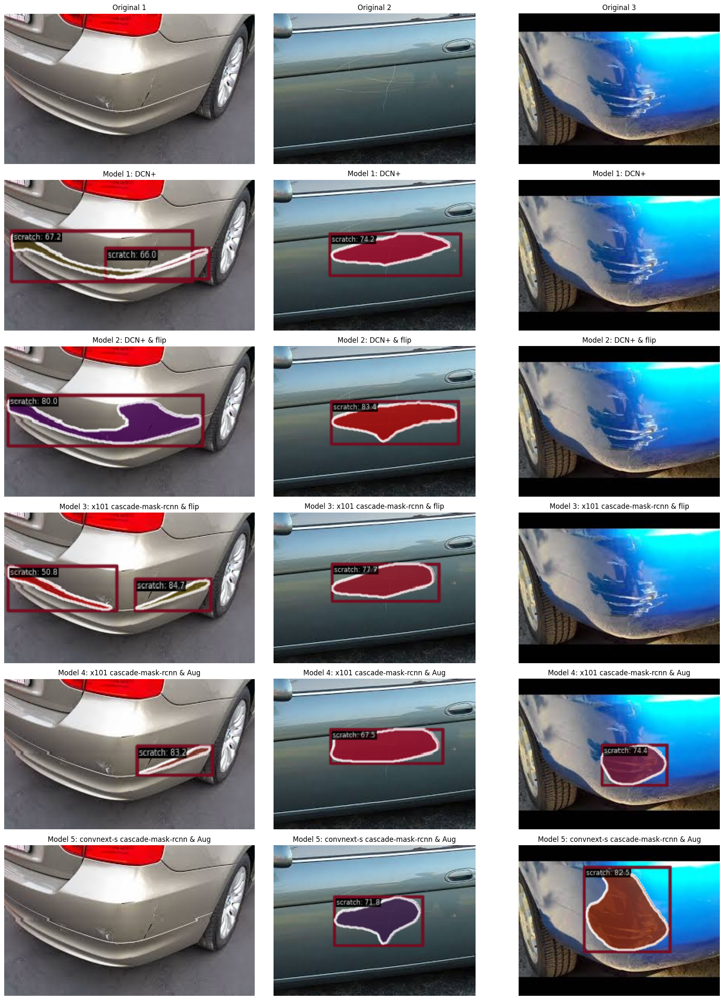

In [ ]:
img_paths = [
    "/content/drive/MyDrive/all_models_images/damage/small/0007.jpg",
    "/content/drive/MyDrive/all_models_images/damage/small/0049.jpg",
    "/content/drive/MyDrive/all_models_images/damage/small/0027.jpg"]

# all config files
model_cfg_ckpts = [
    ("/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_cfg.py", "/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth"),
]

compare_models_on_images(img_paths, model_cfg_ckpts, threshold=0.5, device=0)

Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:50:06 - mmengine - INFO - DeformConv2

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:50:07 - mmengine - INFO - DeformConv2dPa

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:50:09 - mmengine - INFO - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:50:11 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:50:11 - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth


/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:48: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return conv.wrap(result, to_scalar=False)
/content/mmdetection/mmdet/models/roi_heads/mask_heads/fcn_mask_head.py:339: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than tensor.new_tensor(sourceTensor).
  mask_preds

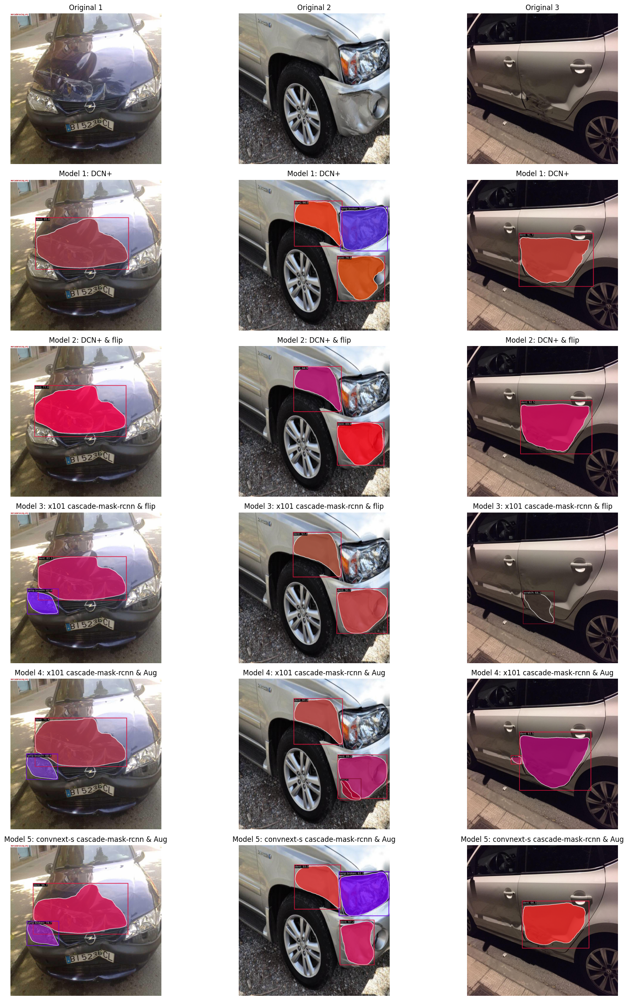

In [ ]:
img_paths = [
    "/content/drive/MyDrive/all_models_images/damage/medium/4.jpg",
    "/content/drive/MyDrive/all_models_images/damage/medium/1.jpg",
    "/content/drive/MyDrive/all_models_images/damage/medium/3.jpg"]

# all config files
model_cfg_ckpts = [
    ("/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_cfg.py", "/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth"),
]

compare_models_on_images(img_paths, model_cfg_ckpts, threshold=0.5, device=0)

Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:48:37 - mmengine - INFO - DeformConv2

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:48:38 - mmengine - INFO - DeformConv2dPa

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:48:40 - mmengine - INFO - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 19:48:41 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 19:48:41 - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth


/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:48: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return conv.wrap(result, to_scalar=False)
/content/mmdetection/mmdet/models/roi_heads/mask_heads/fcn_mask_head.py:339: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than tensor.new_tensor(sourceTensor).
  mask_preds

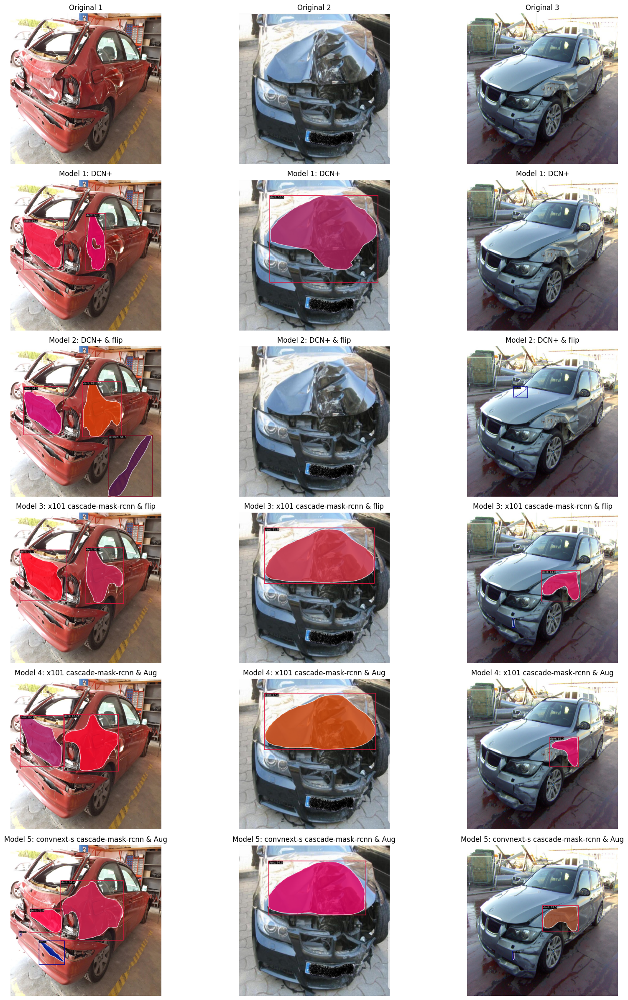

In [ ]:
img_paths = [
    "/content/drive/MyDrive/all_models_images/damage/large/1.jpg",
    "/content/drive/MyDrive/all_models_images/damage/large/2.jpg",
    "/content/drive/MyDrive/all_models_images/damage/large/5.jpg"]

# all config files
model_cfg_ckpts = [
    ("/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_cfg.py", "/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth"),
]

compare_models_on_images(img_paths, model_cfg_ckpts, threshold=0.5, device=0)

Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 20:08:18 - mmengine - INFO - DeformConv2

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 20:08:19 - mmengine - INFO - DeformConv2dPa

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 20:08:20 - mmengine - INFO - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer1.0.conv2 is upgraded to version 2.
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer1.1.conv2 is upgraded to version 2.
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer1.2.conv2 is upgraded to version 2.
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer2.0.conv2 is upgraded to version 2.
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer2.1.conv2 is upgraded to version 2.
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer2.2.conv2 is upgraded to version 2.
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer2.3.conv2 is upgraded to version 2.
08/14 20:08:22 - mmengine - INFO - DeformConv2dPack backbone.layer3.0.conv2 is upgraded to version 2.
08/14 20:08:22 - 

/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(


Loads checkpoint by local backend from path: /content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth


/content/mmdetection/mmdet/apis/inference.py:90: UserWarning: dataset_meta or class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:48: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return conv.wrap(result, to_scalar=False)
/content/mmdetection/mmdet/models/roi_heads/mask_heads/fcn_mask_head.py:339: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than tensor.new_tensor(sourceTensor).
  mask_preds

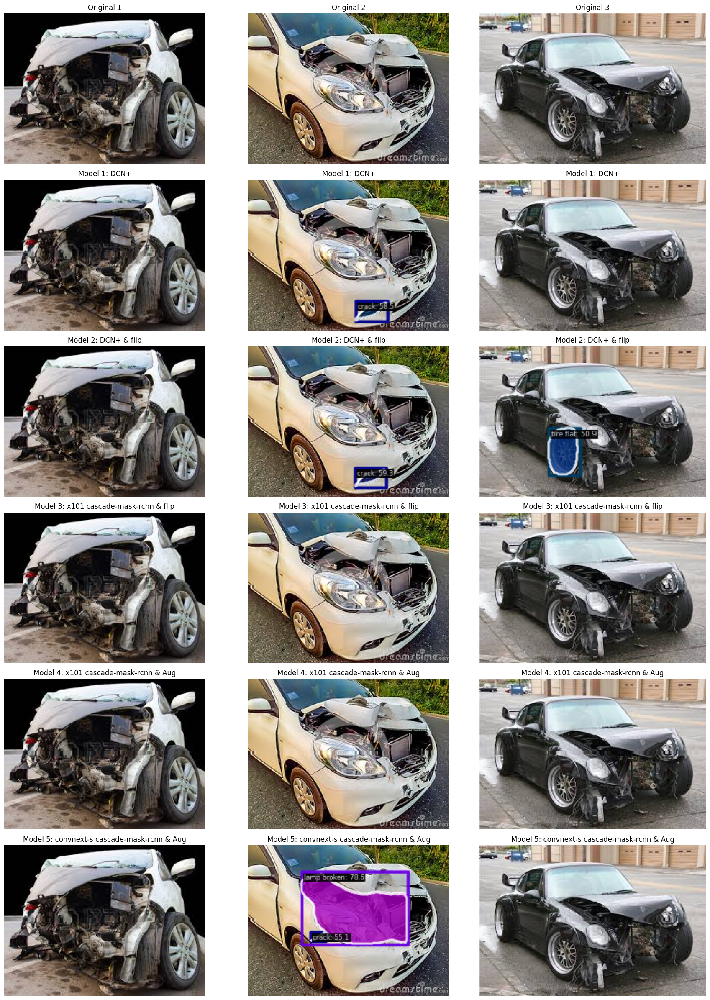

In [ ]:
img_paths = [
    "/content/drive/MyDrive/all_models_images/damage/large/0234.jpg",
    "/content/drive/MyDrive/all_models_images/damage/large/0163.jpg",
    "/content/drive/MyDrive/all_models_images/damage/large/0219.jpg"]

# all config files
model_cfg_ckpts = [
    ("/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v1_dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/dcn_plus_cfg.py", "/content/drive/MyDrive/all_models_images/damage/dcn_plus_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_cfg.py", "/content/drive/MyDrive/all_models_images/damage/v2_albumentations_cascade-mask-rcnn_x101_output_epoch_24_weights_only.pth"),
    ("/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_cfg.py", "/content/drive/MyDrive/all_models_images/damage/albumentations-cascade-mask-rcnn_convnext-s_output_epoch_50_weights_only.pth"),
]

compare_models_on_images(img_paths, model_cfg_ckpts, threshold=0.5, device=0)